In [1]:
# change to the root directory of the project
import os
if os.getcwd().split("/")[-1] == "examples":
    os.chdir('..')
print(os.getcwd())

/mnt/raid/data/anina/ScanDy


In [2]:
import numpy as np
import pandas as pd
import random
import seaborn as sns
import matplotlib.pyplot as plt
import importlib
import scandy_pfc.models.model as base_model 
import scandy_pfc.models.ObjectModel as objectmodel_module
import scandy_pfc.utils.dataclass as dataclass_module
import scandy_pfc.utils.functions as uf
import scandy_pfc.utils.pfc_eval as pfc

from neurolib.utils.parameterSpace import ParameterSpace
from neurolib.optimize.evolution import Evolution

from IPython import display

# Visualization of simulated scanpaths

The visualizations created in this notebook are stored in the `ScanDy/visualizations/` folder.

## Load dataset

```
PictureExample/
├── videos/                 # Folder containing the images (only for visualization)
├── featuremaps/            # Folder containing the precomputed saliency maps
    ├── DG2E_cb/ 
├── polished_segmentation/  # Folder with object segmentation masks
├── topdownmaps/            # Folder with PFC data

```

Create Objects and reload modules - for agile working (changing modules while testing). 

In [3]:
importlib.reload(dataclass_module)
Dataset = dataclass_module.Dataset
importlib.reload(base_model)
importlib.reload(objectmodel_module)
ObjectModel = objectmodel_module.ObjectModel



Define Dataset

In [4]:
datadict = {
    "PATH": "PictureExample/", 
    'FPS' : 30,
    'PX_TO_DVA' : (47.7 * 0.8) / 1920,
    'FRAMES_ALL_VIDS' : 150,
    'VID_EXTENSION' : 'png',
    'gt_foveation_df' : 'df_all_fovs_psycsci.csv',
    "outputpath" : os.getcwd()+"/visualizations/"  # path for saving the visualizations
}
VidCom = Dataset(datadict)
# For faster processing during testing, resize the videos to smaller dimensions
VidCom.VID_SIZE_Y, VidCom.VID_SIZE_X = 540, 960


VID_SIZE_Y=540, VID_SIZE_X=960
Feature maps shape: (150, 540, 960)
Expected frames: 150


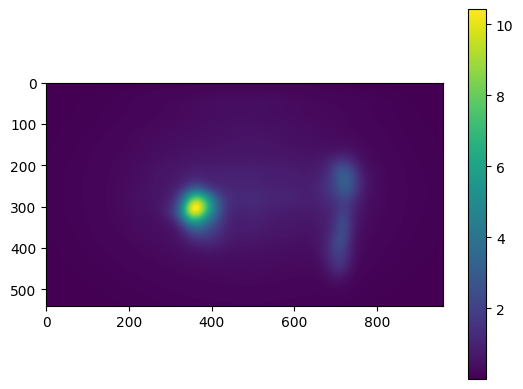

In [5]:
scene = "ballBalance"

featuremap = VidCom.load_featuremaps(scene, featuretype="DG2E_cb", normalized_std=1.0, centerbias="anisotropic_default")
plt.imshow(featuremap[0])
plt.colorbar()

## Initialize a model and specify parameters

We initialize an instance from the object-based model family. We here use high-level saliency maps (DG2E_cb).

In [14]:
params = {
    "featuretype": "DG2E_cb",
    "startpos": "random",
    "ddm_thres": 3.5,
    "ddm_sig": 0.1,
    "att_dva": 7.0, 
    "ior_decay": 150.0,
    "ior_inobj": 0.8,
    "centerbias": None,
}

O_base = ObjectModel(VidCom, params=params)

## Run and evaluate for a single video

Given the model and the dataset, we can now run the scanpath simulation. First we only run it a single time and choose a random seed for reproducibility.



In [15]:
O_base.run(scene, seeds = [1], overwrite_old=True)
O_base.evaluate_all_to_df()
O_base.result_df

VID_SIZE_Y=540, VID_SIZE_X=960
Feature maps shape: (150, 540, 960)
Expected frames: 150


,nfov,video,subject,frame_start,frame_end,duration_ms,x_start,y_start,x_end,y_end,sac_amp_dva,sac_dur,object,sac_angle_h,sac_angle_p,fov_end,fov_start,fov_category,ret_times
0,0,ballBalance,seed001,0,23,775.987929,800,485,782,421,NaN,0.000000,Ground,NaN,NaN,775.987929,0.000000,B,NaN
1,1,ballBalance,seed001,24,42,626.931643,655,391,665,338,2.593592,30.002699,Object 6.825959242284796e-11,-166.709199,NaN,1432.922271,805.990628,D,NaN
2,2,ballBalance,seed001,43,61,582.967656,487,281,488,278,3.714711,33.029721,Object 8.302320964048704e-08,-162.243650,4.465549,2048.919648,1465.951992,D,NaN
3,3,ballBalance,seed001,62,85,779.379394,651,314,664,313,3.317697,31.957781,Object 1.3651918484569592e-10,12.454349,174.697999,2860.256823,2080.877429,D,NaN
4,4,ballBalance,seed001,86,117,1035.413668,702,516,675,524,4.104705,34.082703,Object 6.825959242284796e-11,79.397387,66.943038,3929.753193,2894.339526,R,1461.417255
5,5,ballBalance,seed001,119,149,1020.691893,704,30,720,92,9.835153,49.554914,Ground,-86.640338,-166.037725,5000.000000,3979.308107,B,NaN


We can now qualitatively assess how reasonable this predicted scanpath is by plotting it on top of the "observed" video.

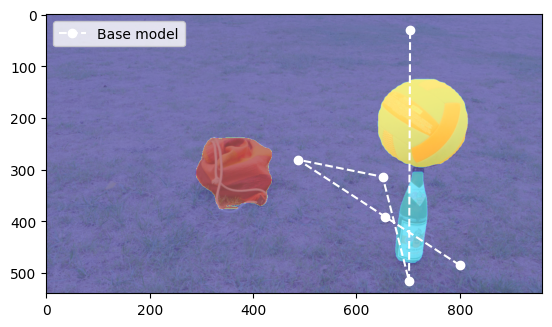

In [16]:
plt.imshow(VidCom.load_videoframes(scene)[0], alpha=0.5)
plt.imshow(VidCom.load_objectmasks(scene)[0], cmap='jet', alpha=0.5)
plt.plot(O_base.result_df.x_start, O_base.result_df.y_start, 'o--', label = 'Base model', color='white')

plt.legend(); plt.show()

## Visualize the different modules for a single scanpath


In [17]:
O_base.write_sgl_output_gif('test', slowgif=True, dpi=100)


Vidlist 150
Saved to /mnt/raid/data/anina/ScanDy/visualizations/test_slow.gif


## Simulate and visualize multiple scanpaths
Due to the stochasticity of the scanpath generation, a single run is not sufficient to assess the quality of the model predictions. Therefore run the simulation multiple times and plot the scanpaths on top of the image.

In [18]:
O_base.run('ballBalance', seeds = [s for s in range(1, 3)], overwrite_old=True)
O_base.evaluate_all_to_df(overwrite_old=True)

VID_SIZE_Y=540, VID_SIZE_X=960
Feature maps shape: (150, 540, 960)
Expected frames: 150


,nfov,video,subject,frame_start,frame_end,duration_ms,x_start,y_start,x_end,y_end,sac_amp_dva,sac_dur,object,sac_angle_h,sac_angle_p,fov_end,fov_start,fov_category,ret_times
0,0,ballBalance,seed001,0,23,775.987929,800,485,782,421,NaN,0.000000,Ground,NaN,NaN,775.987929,0.000000,B,NaN
1,1,ballBalance,seed001,24,42,626.931643,655,391,665,338,2.593592,30.002699,Object 6.825959242284796e-11,-166.709199,NaN,1432.922271,805.990628,D,NaN
2,2,ballBalance,seed001,43,61,582.967656,487,281,488,278,3.714711,33.029721,Object 8.302320964048704e-08,-162.243650,4.465549,2048.919648,1465.951992,D,NaN
3,3,ballBalance,seed001,62,85,779.379394,651,314,664,313,3.317697,31.957781,Object 1.3651918484569592e-10,12.454349,174.697999,2860.256823,2080.877429,D,NaN
4,4,ballBalance,seed001,86,117,1035.413668,702,516,675,524,4.104705,34.082703,Object 6.825959242284796e-11,79.397387,66.943038,3929.753193,2894.339526,R,1461.417255
5,5,ballBalance,seed001,119,149,1020.691893,704,30,720,92,9.835153,49.554914,Ground,-86.640338,-166.037725,5000.000000,3979.308107,B,NaN
6,0,ballBalance,seed002,0,21,713.526323,330,119,291,132,NaN,0.000000,Ground,NaN,NaN,713.526323,0.000000,B,NaN
7,1,ballBalance,seed002,22,65,1423.048082,443,372,442,327,5.646179,38.244684,Object 0.0117647061124444,57.652557,NaN,2174.819089,751.771007,D,NaN
8,2,ballBalance,seed002,66,84,604.265230,817,387,816,429,7.547922,43.379390,Ground,9.090277,-48.562280,2822.463709,2218.198479,B,NaN
9,3,ballBalance,seed002,85,114,960.271152,649,416,610,434,3.329166,31.988749,Object 6.825959242284796e-11,-175.548826,175.360897,3814.723610,2854.452458,D,NaN


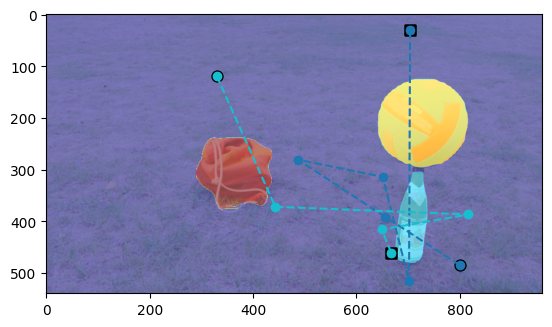

In [19]:
scene = 'ballBalance'  
plt.imshow(VidCom.load_videoframes(scene)[0], alpha=0.5)
plt.imshow(VidCom.load_objectmasks(scene)[0], cmap='jet', alpha=0.5)

fig, ax = plt.gca(), plt.gca()

df = O_base.result_df

seeds = df['subject'].unique()
colors = plt.cm.tab10(np.linspace(0, 1, len(seeds)))

for color, seed in zip(colors, seeds):
    sub = df[df['subject'] == seed]
    ax.plot(sub.x_start,
            sub.y_start,
            'o--',
            label=f'subject {seed}',
            color=color)
    # Start (circle)
    ax.scatter(sub.x_start.iloc[0], sub.y_start.iloc[0],
           s=50, color=color, edgecolor='black', linewidth=1.8, marker='o')

    # End (square)
    ax.scatter(sub.x_start.iloc[-1], sub.y_start.iloc[-1],
            s=50, color=color, edgecolor='black', linewidth=1.8, marker='s')
plt.show()


Circles mark the start of scanpath and square the end. 

In this visualization every color corresponds to a different simulated scanpath (i.e., a different random seed). The video is shown with 30 fps, as in the eye tracking data collection.

Saved to /mnt/raid/data/anina/ScanDy/visualizations/ballBalance_Oll_mean.gif


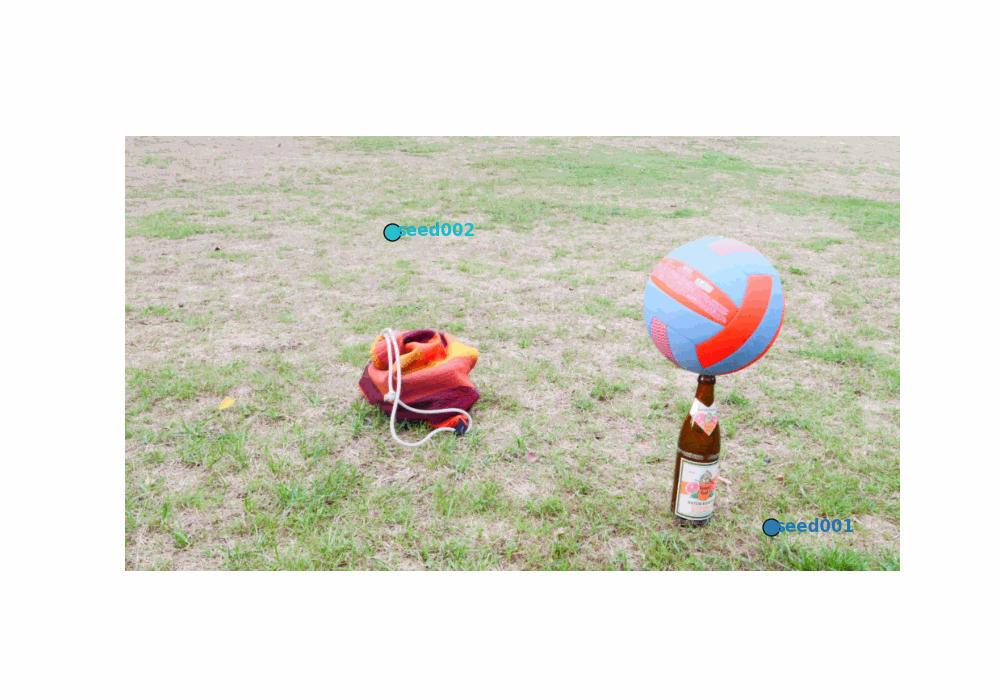

In [ ]:
O_base.video_output_gif('ballBalance', 'ballBalance_Oll_mean', slowgif=False, dpi=100)
display.Image(VidCom.outputpath + 'ballBalance_Oll_mean.gif')

_______________________________________________________________________________________________